In [1]:
import json
from drug_utils import DataHandler
# Load the data from JSON
with open('interactions.json', 'r') as file:
    interactions_data = json.load(file)



In [2]:
import networkx as nx

# Initialize a directed graph
G = nx.DiGraph()

# Scaling factor for edge weights
edge_scaling_factor = 1  # Adjust as needed

# Scaling factor for node weights
node_scaling_factor = 100  # Adjust as needed

# Iterate over the interaction data to add nodes and weighted edges
for drug_data in interactions_data:
    drug = drug_data['name']
    #popularity_weight = calculate_popularity_weight(drug) * node_scaling_factor  # Calculate popularity weight and scale it

    G.add_node(drug)  # Add the drug as a node with scaled popularity weight

    # Add weighted edges for each type of interaction
    # Assuming major interactions are more significant
    for interaction in drug_data['major_interactions']:
        G.add_edge(drug, interaction, weight=3 * edge_scaling_factor)  # Scale edge weight for major interactions
    for interaction in drug_data['minor_interactions']:
        G.add_edge(drug, interaction, weight= 1*edge_scaling_factor)  # Scale edge weight for minor interactions
    for interaction in drug_data['moderate_interactions']:
        G.add_edge(drug, interaction, weight=2* edge_scaling_factor)  # Scale edge weight for moderate interactions



In [4]:
# Create a dictionary to store features of generic drugs
generic_drug_features = {}
# Load the JSON data
with open("testing.json", 'r', encoding='utf-8') as file:
    drugs_data = json.load(file)
generic_drug_features = {}

# Iterate through the drugs data and group features by generic name
for drug in drugs_data:
    generic_name = drug["generic_name"]
    if generic_name not in generic_drug_features:
        generic_drug_features[generic_name] = {
            "drug_classes": [],
            "uses": []
        }
    generic_drug_features[generic_name]["drug_classes"].extend(drug["drug_classes"])
    generic_drug_features[generic_name]["uses"].extend(drug["uses"])


# Remove duplicates from the lists in the dictionary
for generic_name, features in generic_drug_features.items():
    features["drug_classes"] = list(set(features["drug_classes"]))
    features["uses"] = list(set(features["uses"]))
# Example: Get features of drugs with generic name "sulfasalazine"
sulfasalazine_features = generic_drug_features.get("sulfasalazine", {})

# Print the features of drugs with generic name "sulfasalazine"
print("Generic Name:", "sulfasalazine")
print("Drug Classes:", sulfasalazine_features["drug_classes"])
print("Uses:", sulfasalazine_features["uses"])
text_node2 = ' '.join([' '.join(v) if isinstance(v, list) else v for i, v in enumerate(sulfasalazine_features.values())])
print(text_node2)

Generic Name: sulfasalazine
Drug Classes: ['5-aminosalicylates', 'Antirheumatics']
Uses: ['Azulfidine EN-tabs may also be used for purposes not listed in this medication guide.', 'Azulfidine is also used to treat rheumatoid arthritis in children and adults who have used other arthritis medicines that did not work or have stopped working.', "It's not fully understood how sulfasalazine works. Sulfasalazine is too big to be absorbed by your small intestine, but bacteria in your colon can break the bond between 5-ASA and sulfapyridine, which frees 5-ASA to work locally in your colon to help in ulcerative colitis. Sulfasalazine and its metabolites - the other drugs that it is broken down into - are also thought to have a range of immunomodulatory effects. They block or inhibit certain processes in your body, which helps to reduce the activity of your immune system.", 'Sulfasalazine helps to reduce pain and swelling and lowers inflammation in your body. It limits the damage that rheumatoid a

In [5]:

# Define the path to the JSON file
output_file_path = "generic_drug_features2.json"

# Save the features to the JSON file
with open(output_file_path, "w") as json_file:
    json.dump(generic_drug_features, json_file, indent=4)

print(f"Generic drug features saved to {output_file_path}")

Generic drug features saved to generic_drug_features2.json


In [6]:

# Create a list of (node, attributes) pairs from your dictionary
nodes_and_attributes = [(drug, attributes) for drug, attributes in generic_drug_features.items()]

# Add nodes and attributes to the existing graph
G.add_nodes_from(nodes_and_attributes)

# Print node attributes
for node, attributes in G.nodes(data=True):
    print(f"Node: {node}")
    for key, value in attributes.items():
        print(f"{key}: {value}")
    print()

Node: tamoxifen
drug_classes: ['Selective estrogen receptor modulators', 'Hormones / antineoplastics']
uses: ["Soltamox is used to treat some types of breast cancer in men and women. This medicine is also used to lower a woman's chance of developing breast cancer if she has a high risk (such as a family history of breast cancer).", "Tamoxifen is also used to lower a woman's chance of developing breast cancer if she has a high risk (such as a family history of breast cancer).", 'Tamoxifen blocks the actions of estrogen, a female hormone. Certain types of breast cancer require estrogen to grow.', 'Tamoxifen is used to treat some types of breast cancer in men and women.', 'Soltamox may also be used for purposes not listed in this medication guide.']

Node: abiraterone
drug_classes: ['Miscellaneous antineoplastics']
uses: ['Zytiga works by reducing androgen production in the body. Androgens are male hormones that can promote tumor growth in the prostate gland.', 'It is not known if abirate

In [7]:
import networkx as nx
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_extraction.text import TfidfVectorizer
from tqdm import tqdm
def calculate_cosine_similarity(attr_dict1, attr_dict2):
    # Combine attribute values into a single string for each node
    # Handle both list and single string values in attributes
    # Keys to exclude
    exclude_keys = {'drug_classes'}
    if 'uses' not in attr_dict1 or 'uses' not in attr_dict2:
        return 0.0

    text_node1 = ' '.join([' '.join(v) if isinstance(v, list) else v 
                        for k, v in attr_dict1.items() if k not in exclude_keys])

    text_node2 = ' '.join([' '.join(v) if isinstance(v, list) else v 
                        for k, v in attr_dict2.items() if k not in exclude_keys])

    if not text_node1 or not text_node2:
        # Handle the case where there's no text to vectorize, perhaps return 0 or some other default score
        return 0.0
    # Create TF-IDF vectors
    vectorizer = TfidfVectorizer()
    tfidf_matrix = vectorizer.fit_transform([text_node1, text_node2])

    # Compute cosine similarity
    return cosine_similarity(tfidf_matrix[0:1], tfidf_matrix[1:2])[0][0]


In [8]:

# Ensure that G is defined and nodes_and_attributes are added as per your snippet.
edges = G.edges()
# Iterate over edges and assign cosine similarity scores
for edge in tqdm(edges, desc='Calculating cosine similarities'):
    node1, node2 = edge
    attr_dict1 = G.nodes[node1]
    attr_dict2 = G.nodes[node2]
    similarity_score = calculate_cosine_similarity(attr_dict1, attr_dict2)
    # Store the similarity score back into the graph
    G[node1][node2]['cosine_similarity'] = similarity_score


# Print the graph with similarity scores
for edge in G.edges(data=True):
    print(f"{edge[0]} -> {edge[1]}: Cosine Similarity = {edge[2]['cosine_similarity']:.2f}")

Calculating cosine similarities: 100%|██████████| 599880/599880 [16:14<00:00, 615.78it/s] 


tamoxifen -> abiraterone: Cosine Similarity = 0.24
tamoxifen -> adagrasib: Cosine Similarity = 0.30
tamoxifen -> amiodarone: Cosine Similarity = 0.28
tamoxifen -> amisulpride: Cosine Similarity = 0.23
tamoxifen -> anagrelide: Cosine Similarity = 0.20
tamoxifen -> anisindione: Cosine Similarity = 0.00
tamoxifen -> arsenic-trioxide: Cosine Similarity = 0.30
tamoxifen -> bedaquiline: Cosine Similarity = 0.23
tamoxifen -> bepridil: Cosine Similarity = 0.00
tamoxifen -> berotralstat: Cosine Similarity = 0.26
tamoxifen -> bupropion: Cosine Similarity = 0.29
tamoxifen -> cabozantinib: Cosine Similarity = 0.44
tamoxifen -> carfilzomib: Cosine Similarity = 0.30
tamoxifen -> celecoxib: Cosine Similarity = 0.27
tamoxifen -> ceritinib: Cosine Similarity = 0.39
tamoxifen -> chloroquine: Cosine Similarity = 0.29
tamoxifen -> cimetidine: Cosine Similarity = 0.29
tamoxifen -> cinacalcet: Cosine Similarity = 0.32
tamoxifen -> cisapride: Cosine Similarity = 0.00
tamoxifen -> citalopram: Cosine Similarit

In [9]:
# Convert the NetworkX graph to a JSON-serializable format
graph_data = nx.node_link_data(G)

# Save the graph data to a JSON file
with open('graph2.json', 'w') as json_file:
    json.dump(graph_data, json_file)

In [10]:
import networkx as nx
import json
from operator import itemgetter

# Load the graph data from the JSON file
with open('graph2.json', 'r') as json_file:
    graph_data = json.load(json_file)
from operator import itemgetter

# Create a NetworkX graph from the loaded data
G = nx.node_link_graph(graph_data)

# Create a list of nodes and their average edge similarity
node_similarity_list = []

for node in G.nodes:
    neighbors = list(G.neighbors(node))

    similarity_values = []

    for neighbor in neighbors:
        try:
            similarity = G.edges[neighbor, node]['cosine_similarity']
            similarity_values.append((node, neighbor, similarity))
        except KeyError:
            pass

    average_similarity = sum(similarity for _, _, similarity in similarity_values) / len(similarity_values) if similarity_values else 0
    node_similarity_list.append((node, average_similarity, similarity_values))

# Sort the list in descending order of similarity
node_similarity_list.sort(key=itemgetter(1), reverse=True)

# Get the top 10 similar nodes and their similarity scores
top_similar_nodes = node_similarity_list[:20]  # Change 10 to the desired number of top nodes

# Print the top similar nodes and their similarity scores along with the contributing edges
for node, similarity, edges in top_similar_nodes:
    print(f"Node {node} has average edge cosine similarity: {similarity}")
    print("Contributing Edges:")
    for source, target, edge_similarity in edges:
        print(f"Edge ({source}, {target}) with similarity: {edge_similarity}")
    print()


Node miglustat has average edge cosine similarity: 0.7174086395474158
Contributing Edges:
Edge (miglustat, imiglucerase) with similarity: 0.7174086395474158

Node imiglucerase has average edge cosine similarity: 0.7174086395474153
Contributing Edges:
Edge (imiglucerase, miglustat) with similarity: 0.7174086395474153

Node tafluprost-ophthalmic has average edge cosine similarity: 0.6636862729701983
Contributing Edges:
Edge (tafluprost-ophthalmic, bimatoprost-ophthalmic) with similarity: 0.7886064792354339
Edge (tafluprost-ophthalmic, latanoprost-ophthalmic) with similarity: 0.7319532238422185
Edge (tafluprost-ophthalmic, latanoprostene-bunod-ophthalmic) with similarity: 0.7899943712421644
Edge (tafluprost-ophthalmic, omidenepag-isopropyl-ophthalmic) with similarity: 0.42666944774115584
Edge (tafluprost-ophthalmic, travoprost-ophthalmic) with similarity: 0.5812078427900194

Node bimatoprost-ophthalmic has average edge cosine similarity: 0.6534686271794113
Contributing Edges:
Edge (bimato

In [13]:
import networkx as nx
import json
from operator import itemgetter

# Load the graph data from the JSON file
with open('graph2.json', 'r') as json_file:
    graph_data = json.load(json_file)

# Create a NetworkX graph from the loaded data
G = nx.node_link_graph(graph_data)

# Create a list of nodes and their average edge similarity
node_similarity_list = []

for node in G.nodes:
    neighbors = list(G.neighbors(node))
    similarity_values = []

    for neighbor in neighbors:
        try:
            similarity = G.edges[neighbor, node]['cosine_similarity']
            similarity_values.append((node, neighbor, similarity))
        except KeyError:
            pass

    average_similarity = sum(similarity for _, _, similarity in similarity_values) / len(similarity_values) if similarity_values else 0
    node_similarity_list.append((node, average_similarity, similarity_values))

# Sort the list in descending order of similarity
node_similarity_list.sort(key=itemgetter(1), reverse=True)

# Get the top 10 similar nodes and their similarity scores
top_similar_nodes = node_similarity_list[:15]  # Change 10 to the desired number of top nodes

# Print the top similar nodes and their similarity scores along with the contributing edges
for node, similarity, edges in top_similar_nodes:
    if len(edges) > 1:
        print(f"Node {node} has average edge cosine similarity: {similarity}")

Node tafluprost-ophthalmic has average edge cosine similarity: 0.6636862729701983
Node bimatoprost-ophthalmic has average edge cosine similarity: 0.6534686271794113
Node latanoprost-ophthalmic has average edge cosine similarity: 0.6274109929649763
Node latanoprostene-bunod-ophthalmic has average edge cosine similarity: 0.604347873298558
Node benzoyl-peroxide-topical has average edge cosine similarity: 0.6020839563129964
Node sulfur-topical has average edge cosine similarity: 0.5379808182681304
Node cyclosporine-ophthalmic has average edge cosine similarity: 0.5023707684297402
Node travoprost-ophthalmic has average edge cosine similarity: 0.49782270753769015
Node carboprost has average edge cosine similarity: 0.48505174810228324
Node tretinoin-topical has average edge cosine similarity: 0.470582563618513
Node resorcinol-topical has average edge cosine similarity: 0.46496148434381646


In [ ]:
# Sorting edges by cosine similarity
sorted_edges = sorted(G.edges(data=True), key=lambda x: x[2]['cosine_similarity'], reverse=True)
print("Top edges by cosine similarity:", sorted_edges[:10])


Top edges by cosine similarity: [('selpercatinib', 'pralsetinib', {'weight': 1, 'cosine_similarity': 1.0000000000000007}), ('arformoterol', 'olodaterol', {'weight': 1, 'cosine_similarity': 1.0000000000000007}), ('olodaterol', 'arformoterol', {'weight': 1, 'cosine_similarity': 1.0000000000000007}), ('pralsetinib', 'selpercatinib', {'weight': 1, 'cosine_similarity': 1.0000000000000007}), ('acetazolamide', 'methazolamide', {'weight': 3, 'cosine_similarity': 1.0000000000000007}), ('methazolamide', 'acetazolamide', {'weight': 3, 'cosine_similarity': 1.0000000000000007}), ('bosentan', 'macitentan', {'weight': 1, 'cosine_similarity': 1.0000000000000004}), ('idelalisib', 'larotrectinib', {'weight': 3, 'cosine_similarity': 1.0000000000000004}), ('idelalisib', 'rucaparib', {'weight': 1, 'cosine_similarity': 1.0000000000000004}), ('larotrectinib', 'idelalisib', {'weight': 3, 'cosine_similarity': 1.0000000000000004})]


In [17]:
import networkx as nx
from itertools import combinations


# Extracting all unique classes from the graph
all_classes = set()
for _, data in G.nodes(data=True):
    try:
        # Attempt to update the set with 'drug_classes'
        all_classes.update(data['drug_classes'])
    except KeyError:
        # If a KeyError occurs, just pass and continue with the next iteration
        pass

# Creating combinations of classes
class_combinations = list(combinations(all_classes, 2))

# Proceed with the rest of your analysis...


# Analyzing interactions within and between class combinations
# Analyzing interactions, cosine similarities, and total edge weights within class combinations
plot_list = []
for combo in class_combinations:
    # Nodes in this combination
    nodes_in_combo = [node for node, data in G.nodes(data=True) 
                      if 'drug_classes' in data and set(combo).issubset(set(data['drug_classes']))]

    # Subgraph for this combination
    subgraph = G.subgraph(nodes_in_combo)

    if subgraph.number_of_edges() > 0:
        print(f"Analysis for class combination {combo}:")
        print(f" - Number of drugs: {subgraph.number_of_nodes()}")
        print(f" - Number of interactions: {subgraph.number_of_edges()}")

        # Aggregate cosine similarities from the edges
        cosine_similarities = [data['cosine_similarity'] for u, v, data in subgraph.edges(data=True)]
        if cosine_similarities:
            avg_similarity = sum(cosine_similarities) / len(cosine_similarities)
            
            print(f" - Average Cosine Similarity: {avg_similarity:.2f}")

        # Sum up the weights of the edges
        total_edge_weight = sum(data['weight'] for u, v, data in subgraph.edges(data=True))
        print(f" - Total Edge Weight: {total_edge_weight}")
        plot_list.append((combo, total_edge_weight , avg_similarity))

    # else, the combination has no interactions and is skipped



Analysis for class combination ('Impotence agents', 'Agents for pulmonary hypertension'):
 - Number of drugs: 2
 - Number of interactions: 2
 - Average Cosine Similarity: 0.71
 - Total Edge Weight: 6
Analysis for class combination ('HER2 inhibitors', 'EGFR inhibitors'):
 - Number of drugs: 3
 - Number of interactions: 2
 - Average Cosine Similarity: 0.64
 - Total Edge Weight: 2
Analysis for class combination ('Benzodiazepines', 'Benzodiazepine anticonvulsants'):
 - Number of drugs: 4
 - Number of interactions: 12
 - Average Cosine Similarity: 0.56
 - Total Edge Weight: 12
Analysis for class combination ('Selective estrogen receptor modulators', 'Hormones / antineoplastics'):
 - Number of drugs: 3
 - Number of interactions: 2
 - Average Cosine Similarity: 0.44
 - Total Edge Weight: 6
Analysis for class combination ('Amebicides', 'Miscellaneous antibiotics'):
 - Number of drugs: 2
 - Number of interactions: 2
 - Average Cosine Similarity: 0.39
 - Total Edge Weight: 2
Analysis for class c

In [18]:
def normalize_data(data):
    # Extracting total weights and cosine similarities
    total_weights = [item[1] for item in data]
    cosine_similarities = [item[2] for item in data]

    # Normalization function
    def normalize(values):
        min_val = min(values)
        max_val = max(values)
        return [(val - min_val) / (max_val - min_val) for val in values]

    # Normalize the total weights and cosine similarities
    normalized_weights = normalize(total_weights)
    normalized_cosine_similarities = normalize(cosine_similarities)

    # Reconstruct the data with normalized values
    normalized_data = [(data[i][0], normalized_weights[i], normalized_cosine_similarities[i]) for i in range(len(data))]
    return normalized_data
normalized_edge_data = normalize_data(plot_list)
normalized_edge_data

[(('Impotence agents', 'Agents for pulmonary hypertension'),
  0.045454545454545456,
  0.9395453383479903),
 (('HER2 inhibitors', 'EGFR inhibitors'), 0.0, 0.812486422395869),
 (('Benzodiazepines', 'Benzodiazepine anticonvulsants'),
  0.11363636363636363,
  0.6483858448632237),
 (('Selective estrogen receptor modulators', 'Hormones / antineoplastics'),
  0.045454545454545456,
  0.415857680284971),
 (('Amebicides', 'Miscellaneous antibiotics'), 0.0, 0.3093670454919794),
 (('Antihistamines', 'Miscellaneous anxiolytics, sedatives and hypnotics'),
  0.0,
  0.42465550393023854),
 (('Catecholamines', 'Adrenergic bronchodilators'), 0.0, 0.3091767958912918),
 (('Herbal products', 'Miscellaneous antidepressants'),
  0.011363636363636364,
  0.48871575436787096),
 (('Antitussives', 'Opioids (narcotic analgesics)'),
  0.045454545454545456,
  0.0),
 (('TNF alfa inhibitors', 'Antirheumatics'),
  0.18181818181818182,
  0.5281376737475876),
 (('Miscellaneous antibiotics', 'Inhaled anti-infectives'),
  

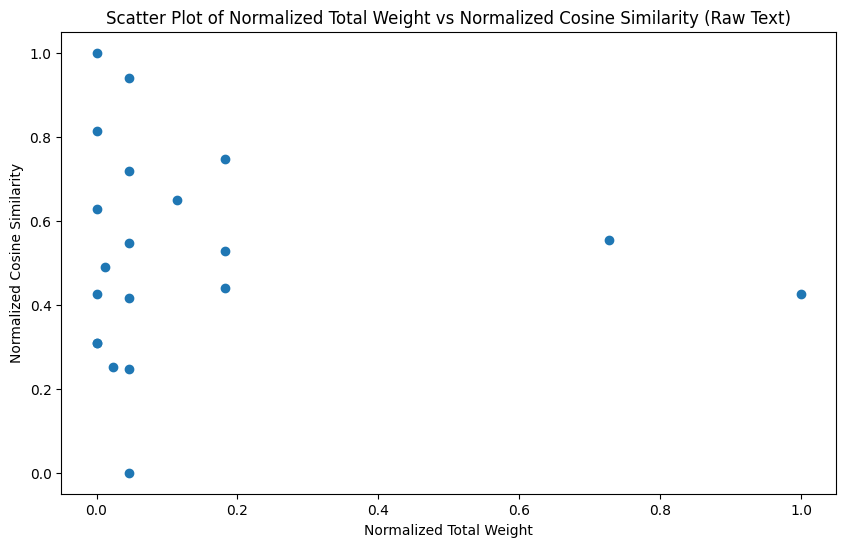

In [22]:
import matplotlib.pyplot as plt
# Separate the normalized values for plotting
edge_names = [item[0] for item in normalized_edge_data]
normalized_weights = [item[1] for item in normalized_edge_data]
normalized_cosine_similarities = [item[2] for item in normalized_edge_data]

# Create the scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(normalized_weights, normalized_cosine_similarities)

# Adding labels for each point

plt.xlabel('Normalized Total Weight')
plt.ylabel('Normalized Cosine Similarity')
plt.title('Scatter Plot of Normalized Total Weight vs Normalized Cosine Similarity (Raw Text)')
plt.show()


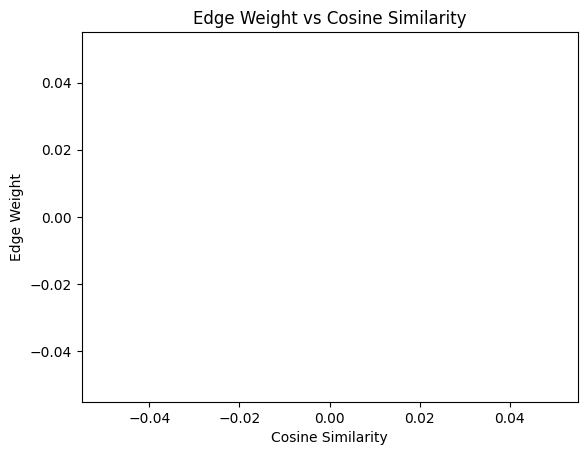

In [14]:
import matplotlib.pyplot as plt

# Lists to hold cosine similarity and weight data
cosine_similarities = []
edge_weights = []

# Iterate over each edge in the subgraph and extract data
for u, v, data in subgraph.edges(data=True):
    cosine_similarities.append(data['cosine_similarity'])
    edge_weights.append(data['weight'])

# Create the scatter plot
plt.scatter(cosine_similarities, edge_weights)
plt.xlabel('Cosine Similarity')
plt.ylabel('Edge Weight')
plt.title('Edge Weight vs Cosine Similarity')
plt.show()


In [ ]:
# Analyzing interactions and pre-stored cosine similarities within class combinations
for combo in class_combinations:
    # Nodes in this combination
    nodes_in_combo = [node for node, data in G.nodes(data=True) 
                      if 'drug_classes' in data and set(combo).issubset(set(data['drug_classes']))]

    # Subgraph for this combination
    subgraph = G.subgraph(nodes_in_combo)

    #if subgraph.number_of_edges() > 0:
    

    # Aggregate cosine similarities from the edges
    cosine_similarities = [data['cosine_similarity'] for u, v, data in subgraph.edges(data=True)]
    if cosine_similarities:
        print(f"Analysis for class combination {combo}:")
        avg_similarity = sum(cosine_similarities) / len(cosine_similarities)
        print(f" - Average Cosine Similarity: {avg_similarity:.2f}")
